In [2]:
# Initial imports
import os
import pandas as pd
from dotenv import load_dotenv
load_dotenv()
from newsapi import NewsApiClient
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')
analyzer = SentimentIntensityAnalyzer()


%matplotlib inline

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\bhuva\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [3]:
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\bhuva\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\bhuva\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\bhuva\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [4]:
# Read your api key environment variable
api_key = "c8a1e7eaa0f6412fba00fd964c1ce000"

In [5]:
# Create a newsapi client
newsapi = NewsApiClient(api_key=api_key)

In [6]:
# Fetch the Bitcoin news articles
btc_headlines = newsapi.get_everything(q="bitcoin", language="en", page_size=100,sort_by="relevancy")
btc_articles = btc_headlines["articles"]
btc_articles[0]

{'source': {'id': None, 'name': 'Gizmodo.com'},
 'author': 'Kyle Barr',
 'title': 'Here’s How to Find the Original Bitcoin Manifesto in Your Mac',
 'description': 'An Apple developer left one of the strangest Easter eggs hidden in the macOS, offering a surprising and baffling connection between the Cupertino tech company’s mainline operating system to everybody’s (least) favorite cryptographic digital currency. Read mor…',
 'url': 'https://gizmodo.com/bitcoin-apple-mac-bitcoin-white-paper-1850307069',
 'urlToImage': 'https://i.kinja-img.com/gawker-media/image/upload/c_fill,f_auto,fl_progressive,g_center,h_675,pg_1,q_80,w_1200/176f6f215c9c45306ca8269f8232701e.jpg',
 'publishedAt': '2023-04-06T15:30:00Z',
 'content': 'An Apple developer left one of the strangest Easter eggs hidden in the macOS, offering a surprising and baffling connection between the Cupertino tech companys mainline operating system to everybodys… [+3865 chars]'}

In [7]:
# Fetch the Ethereum news articles
eth_headlines = newsapi.get_everything(q="ethereum", language="en", page_size=100,sort_by="relevancy")
eth_articles = eth_headlines["articles"]
eth_articles[0]

{'source': {'id': 'google-news', 'name': 'Google News'},
 'author': None,
 'title': 'Ethereum upgrade to unlock over $30 billion in crypto tokens - Reuters',
 'description': 'Ethereum upgrade to unlock over $30 billion in crypto tokens\xa0\xa0Reuters',
 'url': 'https://consent.google.com/ml?continue=https://news.google.com/rss/articles/CBMiZGh0dHBzOi8vd3d3LnJldXRlcnMuY29tL3RlY2hub2xvZ3kvZXRoZXJldW0tdXBncmFkZS11bmxvY2stb3Zlci0zMC1iaWxsaW9uLWNyeXB0by10b2tlbnMtMjAyMy0wNC0xMi_SAQA?oc%3D5%26hl%3Den-CA%26gl%3DCA%26ceid%3DCA:en&gl=FR&hl=en-CA&cm=2&pc=n&src=1',
 'urlToImage': None,
 'publishedAt': '2023-04-12T08:02:00Z',
 'content': 'We use cookies and data to<ul><li>Deliver and maintain Google services</li><li>Track outages and protect against spam, fraud, and abuse</li><li>Measure audience engagement and site statistics to unde… [+1131 chars]'}

In [8]:
# Create the Bitcoin sentiment scores DataFrame
btc_sentiments = []

for article in btc_articles:
    try:
        text = article["content"]
        date = article["publishedAt"][:10]
        sentiment = analyzer.polarity_scores(text)
        compound = sentiment["compound"]
        pos = sentiment["pos"]
        neu = sentiment["neu"]
        neg = sentiment["neg"]
        
        btc_sentiments.append({
            "text": text,
            "date": date,
            "compound": compound,
            "positive": pos,
            "negative": neg,
            "neutral": neu
            
        })
        
    except AttributeError:
        pass
    
# Create DataFrame
btc_df = pd.DataFrame(btc_sentiments)

# Reorder DataFrame columns
cols = ["date", "text", "compound", "positive", "negative", "neutral"]
btc_df = btc_df[cols]

In [9]:
# Drop duplicates articles
btc_df.drop_duplicates(keep="first", inplace=True)
btc_df.head()

,date,text,compound,positive,negative,neutral
0,2023-04-06,An Apple developer left one of the strangest E...,0.2732,0.065,0.000,0.935
1,2023-04-04,We use cookies and data to<ul><li>Deliver and ...,-0.1779,0.160,0.181,0.659
2,2023-03-14,We use cookies and data to<ul><li>Deliver and ...,-0.1779,0.160,0.181,0.659
3,2023-04-05,Michael Saylor is facing a $100 million lawsui...,-0.2263,0.000,0.060,0.940
4,2023-03-20,We use cookies and data to<ul><li>Deliver and ...,-0.1779,0.160,0.181,0.659


In [10]:
# Create the ethereum sentiment scores DataFrame
eth_sentiments = []

for article in eth_articles:
    try:
        text = article["content"]
        date = article["publishedAt"][:10]
        sentiment = analyzer.polarity_scores(text)
        compound = sentiment["compound"]
        pos = sentiment["pos"]
        neu = sentiment["neu"]
        neg = sentiment["neg"]
        
        eth_sentiments.append({
            "text": text,
            "date": date,
            "compound": compound,
            "positive": pos,
            "negative": neg,
            "neutral": neu
            
        })
        
    except AttributeError:
        pass
    
# Create DataFrame
eth_df = pd.DataFrame(eth_sentiments)

# Reorder DataFrame columns
cols = ["date", "text", "compound", "positive", "negative", "neutral"]
eth_df = eth_df[cols]

In [11]:
# Drop duplicates articles
eth_df.drop_duplicates(keep="first", inplace=True)
eth_df.head()

,date,text,compound,positive,negative,neutral
0,2023-04-12,We use cookies and data to<ul><li>Deliver and ...,-0.1779,0.160,0.181,0.659
1,2023-04-13,The so-called Shanghai update enables investor...,0.7003,0.149,0.000,0.851
2,2023-04-14,Ethereum cofounder Vitalik Buterin.Michael Cia...,0.0000,0.000,0.000,1.000
3,2023-04-04,Ethereum's cryptocurrency ether rose 35% in Ma...,0.0000,0.000,0.000,1.000
4,2023-04-10,Connect with top gaming leaders in Los Angeles...,0.0000,0.054,0.054,0.893


In [12]:
# Describe the Bitcoin Sentiment
btc_df.describe()

,compound,positive,negative,neutral
count,99.000000,99.000000,99.000000,99.000000
mean,0.044425,0.072051,0.060374,0.867576
std,0.397952,0.066242,0.072495,0.103419
min,-0.915300,0.000000,0.000000,0.597000
25%,-0.177900,0.000000,0.000000,0.802500
50%,0.000000,0.071000,0.055000,0.870000
75%,0.329100,0.102000,0.091500,0.937500
max,0.888300,0.330000,0.315000,1.000000


In [13]:
# Describe the Ethereum Sentiment
eth_df.describe()

,compound,positive,negative,neutral
count,100.000000,100.000000,100.00000,100.000000
mean,0.189840,0.079910,0.03519,0.884940
std,0.421787,0.077165,0.06343,0.093362
min,-0.925300,0.000000,0.00000,0.651000
25%,0.000000,0.000000,0.00000,0.828500
50%,0.165150,0.075000,0.00000,0.886000
75%,0.530350,0.137250,0.05775,1.000000
max,0.904200,0.318000,0.28000,1.000000


---

In [14]:
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer, PorterStemmer
from string import punctuation
import regex
import re

In [15]:
btc_text_df = btc_df['text'].astype('string')
btc_text_df

0     An Apple developer left one of the strangest E...
1     We use cookies and data to<ul><li>Deliver and ...
2     We use cookies and data to<ul><li>Deliver and ...
3     Michael Saylor is facing a $100 million lawsui...
4     We use cookies and data to<ul><li>Deliver and ...
                            ...                        
95    Cryptocurrency transactions are secure and tru...
96    In every copy of macOS that has shipped since ...
97    An excellent discussion between Balaji and my ...
98    What happened
Cryptocurrencies are having a b...
99    What happened
Cryptocurrencies soared this we...
Name: text, Length: 99, dtype: string

In [16]:
eth_text_df = eth_df['text'].astype('string')
eth_text_df

0     We use cookies and data to<ul><li>Deliver and ...
1     The so-called Shanghai update enables investor...
2     Ethereum cofounder Vitalik Buterin.Michael Cia...
3     Ethereum's cryptocurrency ether rose 35% in Ma...
4     Connect with top gaming leaders in Los Angeles...
                            ...                        
95    Key Takeaways15% of the ETH supply had been lo...
96    The entire cryptocurrency market is currently ...
97    Most cryptocurrencies have been soaring in 202...
98    If you thought Web3 or the metaverse were goin...
99    Before the recent surge in prices, the beginni...
Name: text, Length: 100, dtype: string

In [17]:
# Complete the tokenizer function
def tokenizer(text):

    """Tokenizes text."""

    # Create a list of the words
    words = [word_tokenize(sentence) for sentence in text]

    # Remove punctuation using regex; Remove any non-string character and replace with empty space
    regex = re.compile("[^a-zA-Z ]")
    re_clean = regex.sub('', text)
    words_clean = word_tokenize(re_clean)
   
   # Remove the stop words
    sw = set(stopwords.words('english'))
    first_pass = [word for word in words_clean if word not in sw]

    # Define additional stopwords
    sw_addon = {'char', 'chars' 'la', 'im','volod', 'drin', 'wa', 'ha'}
    second_pass = [word.lower() for word in words_clean if word.lower() not in sw.union(sw_addon)] 

    # Lemmatize Words into root words; convert the words to lowercase
    lemmatizer = WordNetLemmatizer()
    lem = [lemmatizer.lemmatize(word) for word in words_clean]
    tokens = [word.lower() for word in lem if word.lower() not in sw.union(sw_addon)] 
  
    return tokens

In [18]:
# Tokenizing article in the first row of the "text" column
tokenizer(btc_text_df[0])

['apple',
 'developer',
 'left',
 'one',
 'strangest',
 'easter',
 'egg',
 'hidden',
 'macos',
 'offering',
 'surprising',
 'baffling',
 'connection',
 'cupertino',
 'tech',
 'company',
 'mainline',
 'operating',
 'system',
 'everybodys']

In [19]:
# Create for-loop to iterate through rows in the "text" column 
btc_tokens = []
for row in btc_text_df:
    token = tokenizer(row)
    btc_tokens.append(token)

    print(btc_tokens) 

[['apple', 'developer', 'left', 'one', 'strangest', 'easter', 'egg', 'hidden', 'macos', 'offering', 'surprising', 'baffling', 'connection', 'cupertino', 'tech', 'company', 'mainline', 'operating', 'system', 'everybodys']]
[['apple', 'developer', 'left', 'one', 'strangest', 'easter', 'egg', 'hidden', 'macos', 'offering', 'surprising', 'baffling', 'connection', 'cupertino', 'tech', 'company', 'mainline', 'operating', 'system', 'everybodys'], ['use', 'cooky', 'data', 'toullideliver', 'maintain', 'google', 'serviceslilitrack', 'outage', 'protect', 'spam', 'fraud', 'abuselilimeasure', 'audience', 'engagement', 'site', 'statistic', 'unde']]
[['apple', 'developer', 'left', 'one', 'strangest', 'easter', 'egg', 'hidden', 'macos', 'offering', 'surprising', 'baffling', 'connection', 'cupertino', 'tech', 'company', 'mainline', 'operating', 'system', 'everybodys'], ['use', 'cooky', 'data', 'toullideliver', 'maintain', 'google', 'serviceslilitrack', 'outage', 'protect', 'spam', 'fraud', 'abuselilime

In [20]:
# Create a new tokens column for bitcoin
btc_df['btc_token'] = btc_tokens
btc_df.head()

,date,text,compound,positive,negative,neutral,btc_token
0,2023-04-06,An Apple developer left one of the strangest E...,0.2732,0.065,0.000,0.935,"[apple, developer, left, one, strangest, easte..."
1,2023-04-04,We use cookies and data to<ul><li>Deliver and ...,-0.1779,0.160,0.181,0.659,"[use, cooky, data, toullideliver, maintain, go..."
2,2023-03-14,We use cookies and data to<ul><li>Deliver and ...,-0.1779,0.160,0.181,0.659,"[use, cooky, data, toullideliver, maintain, go..."
3,2023-04-05,Michael Saylor is facing a $100 million lawsui...,-0.2263,0.000,0.060,0.940,"[michael, saylor, facing, million, lawsuit, ta..."
4,2023-03-20,We use cookies and data to<ul><li>Deliver and ...,-0.1779,0.160,0.181,0.659,"[use, cooky, data, toullideliver, maintain, go..."


In [21]:
eth_tokens = []
for row in eth_text_df:
    token = tokenizer(row)
    eth_tokens.append(token)

    print(eth_tokens) 

[['use', 'cooky', 'data', 'toullideliver', 'maintain', 'google', 'serviceslilitrack', 'outage', 'protect', 'spam', 'fraud', 'abuselilimeasure', 'audience', 'engagement', 'site', 'statistic', 'unde']]
[['use', 'cooky', 'data', 'toullideliver', 'maintain', 'google', 'serviceslilitrack', 'outage', 'protect', 'spam', 'fraud', 'abuselilimeasure', 'audience', 'engagement', 'site', 'statistic', 'unde'], ['socalled', 'shanghai', 'update', 'enables', 'investor', 'queue', 'withdraw', 'ether', 'coin', 'pledged', 'help', 'operate', 'network', 'return', 'reward', 'process', 'called', 'staking', 'tim', 'beiko', 'h']]
[['use', 'cooky', 'data', 'toullideliver', 'maintain', 'google', 'serviceslilitrack', 'outage', 'protect', 'spam', 'fraud', 'abuselilimeasure', 'audience', 'engagement', 'site', 'statistic', 'unde'], ['socalled', 'shanghai', 'update', 'enables', 'investor', 'queue', 'withdraw', 'ether', 'coin', 'pledged', 'help', 'operate', 'network', 'return', 'reward', 'process', 'called', 'staking', 

In [22]:
# Create a new tokens column for ethereum
eth_df['eth_token'] = eth_tokens
eth_df.head()

,date,text,compound,positive,negative,neutral,eth_token
0,2023-04-12,We use cookies and data to<ul><li>Deliver and ...,-0.1779,0.160,0.181,0.659,"[use, cooky, data, toullideliver, maintain, go..."
1,2023-04-13,The so-called Shanghai update enables investor...,0.7003,0.149,0.000,0.851,"[socalled, shanghai, update, enables, investor..."
2,2023-04-14,Ethereum cofounder Vitalik Buterin.Michael Cia...,0.0000,0.000,0.000,1.000,"[ethereum, cofounder, vitalik, buterinmichael,..."
3,2023-04-04,Ethereum's cryptocurrency ether rose 35% in Ma...,0.0000,0.000,0.000,1.000,"[ethereums, cryptocurrency, ether, rose, march..."
4,2023-04-10,Connect with top gaming leaders in Los Angeles...,0.0000,0.054,0.054,0.893,"[connect, top, gaming, leader, los, angeles, g..."


---

# NGrams and Frequency Analysis

In this section you will look at the ngrams and word frequency for each coin. 

1. Use NLTK to produce the n-grams for N = 2. 
2. List the top 10 words for each coin. 

In [23]:
from collections import Counter
from nltk import ngrams

In [24]:
# Create one list of tokens from list of tokens in each row
btc_processed = []
for row in btc_df['btc_token']:
    for item in row:
        btc_processed.append(item)
        print(btc_processed)

['apple']
['apple', 'developer']
['apple', 'developer', 'left']
['apple', 'developer', 'left', 'one']
['apple', 'developer', 'left', 'one', 'strangest']
['apple', 'developer', 'left', 'one', 'strangest', 'easter']
['apple', 'developer', 'left', 'one', 'strangest', 'easter', 'egg']
['apple', 'developer', 'left', 'one', 'strangest', 'easter', 'egg', 'hidden']
['apple', 'developer', 'left', 'one', 'strangest', 'easter', 'egg', 'hidden', 'macos']
['apple', 'developer', 'left', 'one', 'strangest', 'easter', 'egg', 'hidden', 'macos', 'offering']
['apple', 'developer', 'left', 'one', 'strangest', 'easter', 'egg', 'hidden', 'macos', 'offering', 'surprising']
['apple', 'developer', 'left', 'one', 'strangest', 'easter', 'egg', 'hidden', 'macos', 'offering', 'surprising', 'baffling']
['apple', 'developer', 'left', 'one', 'strangest', 'easter', 'egg', 'hidden', 'macos', 'offering', 'surprising', 'baffling', 'connection']
['apple', 'developer', 'left', 'one', 'strangest', 'easter', 'egg', 'hidden',

In [25]:
eth_processed = []
for row in eth_df['eth_token']:
    for item in row:
        eth_processed.append(item)
        print(eth_processed)

['use']
['use', 'cooky']
['use', 'cooky', 'data']
['use', 'cooky', 'data', 'toullideliver']
['use', 'cooky', 'data', 'toullideliver', 'maintain']
['use', 'cooky', 'data', 'toullideliver', 'maintain', 'google']
['use', 'cooky', 'data', 'toullideliver', 'maintain', 'google', 'serviceslilitrack']
['use', 'cooky', 'data', 'toullideliver', 'maintain', 'google', 'serviceslilitrack', 'outage']
['use', 'cooky', 'data', 'toullideliver', 'maintain', 'google', 'serviceslilitrack', 'outage', 'protect']
['use', 'cooky', 'data', 'toullideliver', 'maintain', 'google', 'serviceslilitrack', 'outage', 'protect', 'spam']
['use', 'cooky', 'data', 'toullideliver', 'maintain', 'google', 'serviceslilitrack', 'outage', 'protect', 'spam', 'fraud']
['use', 'cooky', 'data', 'toullideliver', 'maintain', 'google', 'serviceslilitrack', 'outage', 'protect', 'spam', 'fraud', 'abuselilimeasure']
['use', 'cooky', 'data', 'toullideliver', 'maintain', 'google', 'serviceslilitrack', 'outage', 'protect', 'spam', 'fraud', '

In [26]:
# Generate the Bitcoin N-grams where N=2
btc_bigram = Counter(ngrams(btc_processed, n=2))
print(dict(btc_bigram))


{('apple', 'developer'): 1, ('developer', 'left'): 1, ('left', 'one'): 1, ('one', 'strangest'): 1, ('strangest', 'easter'): 1, ('easter', 'egg'): 2, ('egg', 'hidden'): 2, ('hidden', 'macos'): 1, ('macos', 'offering'): 1, ('offering', 'surprising'): 1, ('surprising', 'baffling'): 1, ('baffling', 'connection'): 1, ('connection', 'cupertino'): 1, ('cupertino', 'tech'): 1, ('tech', 'company'): 1, ('company', 'mainline'): 1, ('mainline', 'operating'): 1, ('operating', 'system'): 2, ('system', 'everybodys'): 1, ('everybodys', 'use'): 1, ('use', 'cooky'): 5, ('cooky', 'data'): 5, ('data', 'toullideliver'): 5, ('toullideliver', 'maintain'): 5, ('maintain', 'google'): 5, ('google', 'serviceslilitrack'): 5, ('serviceslilitrack', 'outage'): 5, ('outage', 'protect'): 5, ('protect', 'spam'): 5, ('spam', 'fraud'): 5, ('fraud', 'abuselilimeasure'): 5, ('abuselilimeasure', 'audience'): 5, ('audience', 'engagement'): 5, ('engagement', 'site'): 5, ('site', 'statistic'): 5, ('statistic', 'unde'): 5, ('un

In [27]:
# Print 20 most common Bitcoin bigrams
print(dict(btc_bigram.most_common(20)))

{('us', 'stock'): 13, ('new', 'york'): 13, ('interest', 'rate'): 7, ('york', 'stock'): 7, ('stock', 'exchange'): 7, ('federal', 'reserve'): 6, ('silicon', 'valley'): 6, ('imagesullius', 'stock'): 6, ('floor', 'new'): 6, ('use', 'cooky'): 5, ('cooky', 'data'): 5, ('data', 'toullideliver'): 5, ('toullideliver', 'maintain'): 5, ('maintain', 'google'): 5, ('google', 'serviceslilitrack'): 5, ('serviceslilitrack', 'outage'): 5, ('outage', 'protect'): 5, ('protect', 'spam'): 5, ('spam', 'fraud'): 5, ('fraud', 'abuselilimeasure'): 5}


In [28]:
# Generate the Ethereum N-grams where N=2
eth_bigram = Counter(ngrams(eth_processed, n=2))
print(dict(eth_bigram))


{('use', 'cooky'): 1, ('cooky', 'data'): 1, ('data', 'toullideliver'): 1, ('toullideliver', 'maintain'): 1, ('maintain', 'google'): 1, ('google', 'serviceslilitrack'): 1, ('serviceslilitrack', 'outage'): 1, ('outage', 'protect'): 1, ('protect', 'spam'): 1, ('spam', 'fraud'): 1, ('fraud', 'abuselilimeasure'): 1, ('abuselilimeasure', 'audience'): 1, ('audience', 'engagement'): 1, ('engagement', 'site'): 1, ('site', 'statistic'): 1, ('statistic', 'unde'): 1, ('unde', 'socalled'): 1, ('socalled', 'shanghai'): 1, ('shanghai', 'update'): 2, ('update', 'enables'): 1, ('enables', 'investor'): 1, ('investor', 'queue'): 1, ('queue', 'withdraw'): 1, ('withdraw', 'ether'): 1, ('ether', 'coin'): 1, ('coin', 'pledged'): 1, ('pledged', 'help'): 1, ('help', 'operate'): 1, ('operate', 'network'): 1, ('network', 'return'): 1, ('return', 'reward'): 1, ('reward', 'process'): 1, ('process', 'called'): 1, ('called', 'staking'): 1, ('staking', 'tim'): 1, ('tim', 'beiko'): 1, ('beiko', 'h'): 1, ('h', 'ethereu

In [29]:
# Print 20 most common Ethereum bigrams
print(dict(eth_bigram.most_common(20)))

{('ethereum', 'eth'): 10, ('crypto', 'market'): 9, ('shanghai', 'upgrade'): 6, ('cryptocurrency', 'market'): 5, ('upgrade', 'ethereum'): 4, ('shapella', 'upgrade'): 4, ('month', 'high'): 3, ('connect', 'top'): 3, ('top', 'gaming'): 3, ('gaming', 'leader'): 3, ('leader', 'los'): 3, ('los', 'angeles'): 3, ('angeles', 'gamesbeat'): 3, ('gamesbeat', 'summit'): 3, ('summit', 'may'): 3, ('may', 'register'): 3, ('bitcoin', 'btc'): 3, ('software', 'upgrade'): 3, ('last', 'hour'): 3, ('market', 'cap'): 3}


In [30]:
# Use the token_count function to generate the top 10 words from each coin
def token_count(tokens, N=10):
    """Returns the top N tokens from the frequency count"""
    return Counter(tokens).most_common(N)

In [31]:
# Get the top 10 words for Bitcoin
btc_top_ten = token_count(btc_processed)
btc_top_ten

[('stock', 43),
 ('bitcoin', 27),
 ('us', 26),
 ('banking', 18),
 ('bank', 16),
 ('investor', 16),
 ('new', 16),
 ('data', 13),
 ('york', 13),
 ('price', 11)]

In [32]:
# Get the top 10 words for Ethereum
eth_top_ten = token_count(eth_processed)
eth_top_ten

[('ethereum', 43),
 ('crypto', 34),
 ('market', 21),
 ('eth', 21),
 ('upgrade', 18),
 ('cryptocurrency', 16),
 ('year', 16),
 ('shanghai', 14),
 ('price', 13),
 ('week', 13)]

# Word Clouds

In this section, you will generate word clouds for each coin to summarize the news for each coin

In [33]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = [20.0, 10.0]

C:\Users\bhuva\AppData\Local\Temp\ipykernel_13924\2772510350.py:3: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid')


Text(0.5, 1.0, 'Bitcoin Word Cloud')

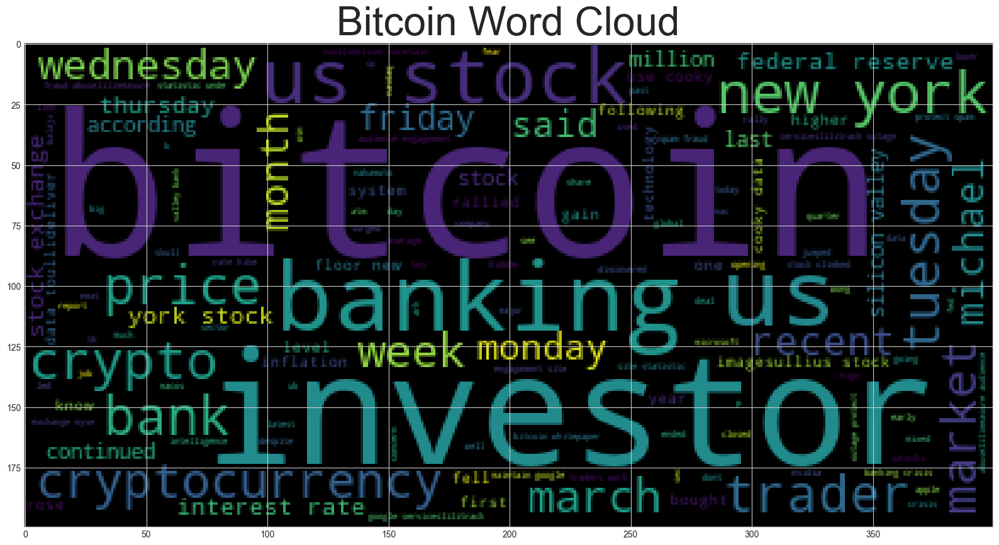

In [34]:
# Generate the Bitcoin word cloud
wc = WordCloud().generate(' '.join(btc_processed))
plt.imshow(wc)

# Add title to a Bitcoin Word Cloud 
plt.title("Bitcoin Word Cloud", fontdict={"fontsize":46})

Text(0.5, 1.0, 'Ethereum Word Cloud')

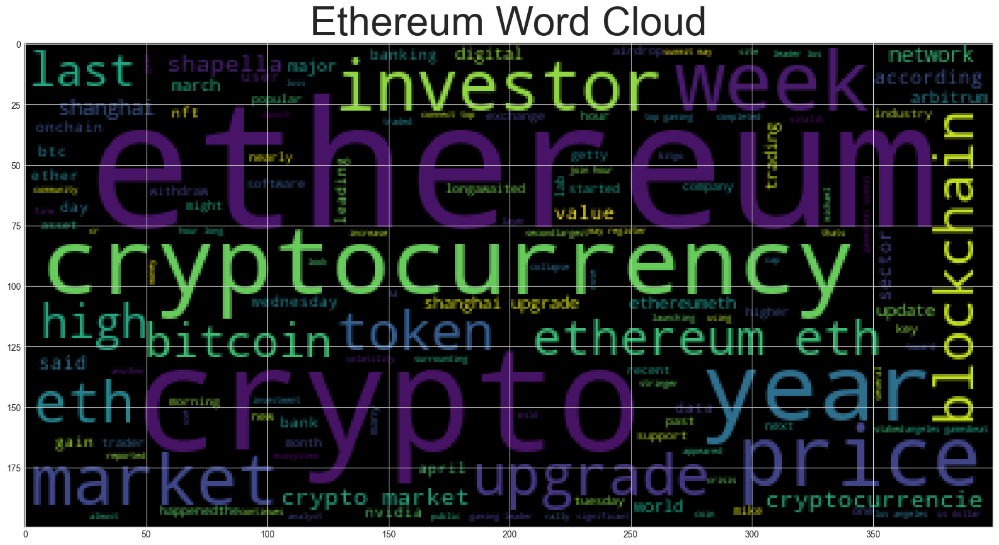

In [35]:
# Generate the Ethereum word cloud
wc = WordCloud().generate(" ".join(eth_processed))
plt.imshow(wc)

# Add title to a Ethereum Word Cloud 
plt.title("Ethereum Word Cloud", fontdict={"fontsize":46})

# Named Entity Recognition

In this section, you will build a named entity recognition model for both coins and visualize the tags using SpaCy.

In [36]:
import spacy
from spacy import displacy

In [38]:
# Load the spaCy model
nlp = spacy.load('en_core_web_sm')

## Bitcoin NER

In [39]:
# Concatenate all of the bitcoin text together
btc_joined = " ".join(btc_processed)

In [40]:
# Run the NER processor on all of the text
doc_btc = nlp(btc_joined)

# Add a title to the document
doc_btc.user_data["title"] = "Bitcoin NER"

In [41]:
# Render the visualization
displacy.render(doc_btc, style='ent')

In [42]:
# List all Entities
print([ent.text for ent in doc_btc.ents])

['one', 'hidden macos', 'michael saylor', 'million', 'early april', 'first', 'june last year', 'paul morris', 'andy baio', 'week', 'first', 'june', 'last three month', 'strongest quarter', 'two', 'september', 'hungaryjanos kummer stringer getty images wharton', 'jeremy siegel', 'nearly ninemonth', 'tuesday', 'monday', 'silicon valley bank', 'earlier month', 'mike novogratzmarco', 'month', 'tuesday', 'mike novogratz', 'marke warren', 'billion', 'first quarter', 'apple p', 'last five week', 'friday', 'sec', 'march', 'kraken saiddado', 'august', 'shanghai', 'month', 'tuesday', 'month', 'last year', 'week', 'shanghai', 'tim beiko', 'asian', 'early monday', 'past hour', 'two month', 'keynotethis week', 'one', 'last thursday', 'us', 'district us', 'tuesday', 'mike', 'mike novogratz', 'malicio question', 'first', 'marduk', 'god city', 'tuesday', 'million', 'surgedas one group', 'berlin', 'german', 'wednesday', 'crypt warren', 'friday', 'late thursday', 'billion var', 'tuesday', 'janet yellen'

---

## Ethereum NER

In [43]:
# Concatenate all of the bitcoin text together
eth_joined = " ".join(eth_processed)

In [44]:
# Run the NER processor on all of the text
doc_eth = nlp(eth_joined)

# Add a title to the document
doc_eth.user_data["title"] = "Ethereum NER"

In [45]:
# Render the visualization
displacy.render(doc_eth, style='ent')

In [46]:
# List all Entities
print([ent.text for ent in doc_eth.ents])

['shanghai', 'tim beiko', 'buterinmichael ciaglo stringer', 'thursday', 'march', 'kraken saiddado', 'august', 'shanghai', 'los angeles', 'first', 'marduk', 'god city', 'michael saylors microstrategy', 'last five week', 'friday', 'sec', 'michael kagan', 'ark invest', 'million', 'xrp', 'last week', 'year', 'los angeles', 'korean', 'los angeles', 'today', 'polygon labs launch bloc', 'nearly ninemonth', 'tuesday', 'rele mike novogratzmarco', 'month', 'tuesday', 'mike novogratz', 'marke', 'mike novogratzmarco', 'mike novogratz', 'interview nvidia', 'michael kagancrypto', 'us', 'donald trump', 'july', 'washington', 'last year', 'polygon', 'winter', 'november', 'quantum', 'mogul kwonhe', 'year', 'ether week', 'last hour morning', 'tuesday morning', 'wednesday', 'ethereumeth year', 'shanghai', 'first', 'last weekend', 'sector week', 'past week past day', 'investor week', 'shanghai', 'week', 'tuesday', 'around year', 'shanghai', 'utc', 'april', 'shanghai', 'year ethereumeth year', 'year', 'apri